<a href="https://colab.research.google.com/github/thvarsha00/credit-card-fraud-detection/blob/main/project1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [3]:
# Import Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# ML Tools
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA



In [4]:

# Load the dataset from Drive folder
file_path = '/content/drive/MyDrive/creditcard_data/creditcard.csv'
df = pd.read_csv(file_path)

print(df.head())
print(df.columns)



X = df.drop("Class", axis=1)
y = df["Class"]


   Time        V1        V2        V3        V4        V5        V6        V7  \
0   0.0 -1.359807 -0.072781  2.536347  1.378155 -0.338321  0.462388  0.239599   
1   0.0  1.191857  0.266151  0.166480  0.448154  0.060018 -0.082361 -0.078803   
2   1.0 -1.358354 -1.340163  1.773209  0.379780 -0.503198  1.800499  0.791461   
3   1.0 -0.966272 -0.185226  1.792993 -0.863291 -0.010309  1.247203  0.237609   
4   2.0 -1.158233  0.877737  1.548718  0.403034 -0.407193  0.095921  0.592941   

         V8        V9  ...       V21       V22       V23       V24       V25  \
0  0.098698  0.363787  ... -0.018307  0.277838 -0.110474  0.066928  0.128539   
1  0.085102 -0.255425  ... -0.225775 -0.638672  0.101288 -0.339846  0.167170   
2  0.247676 -1.514654  ...  0.247998  0.771679  0.909412 -0.689281 -0.327642   
3  0.377436 -1.387024  ... -0.108300  0.005274 -0.190321 -1.175575  0.647376   
4 -0.270533  0.817739  ... -0.009431  0.798278 -0.137458  0.141267 -0.206010   

        V26       V27       V28 

# Fraud vs Non-Fraud Distribution



In [5]:

fig = px.histogram(df, x="Class", color="Class",
                   title="Fraud vs Non-Fraud Transactions",
                   labels={"Class": "Transaction Type"})
fig.show()


# Transaction Amount Distribution (Fraud vs Non-Fraud)

The boxplot compares the transaction amounts between fraudulent (1) and non-fraudulent (0) transactions.

Most non-fraud transactions are spread across a wide range of amounts.

Fraudulent transactions tend to involve smaller amounts on average, but a few outliers show very high values.

This suggests fraudsters often attempt small transactions to avoid detection, but sometimes larger amounts are also targeted.

/tmp/ipython-input-305044656.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




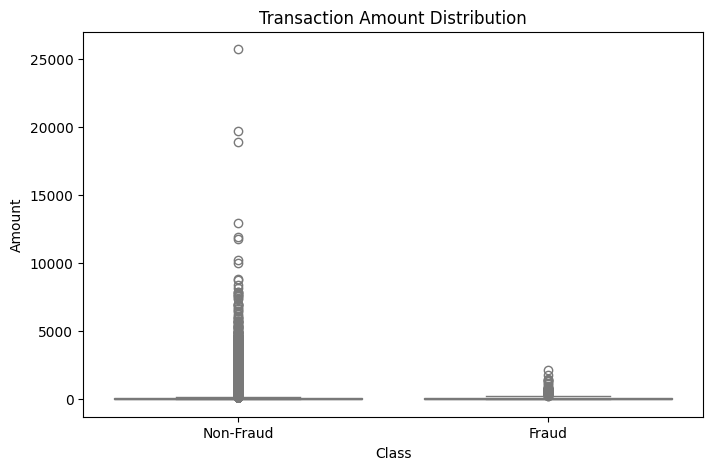

In [22]:
plt.figure(figsize=(8,5))
sns.boxplot(x="Class", y="Amount", data=df, palette="coolwarm")
plt.title("Transaction Amount Distribution")
plt.xticks([0, 1], ['Non-Fraud', 'Fraud'])
plt.show()

# Fraud vs Non-Fraud by Transaction Amount (Log Scale)

This histogram compares transaction amounts for fraudulent and non-fraudulent cases on a logarithmic scale for clearer visibility.

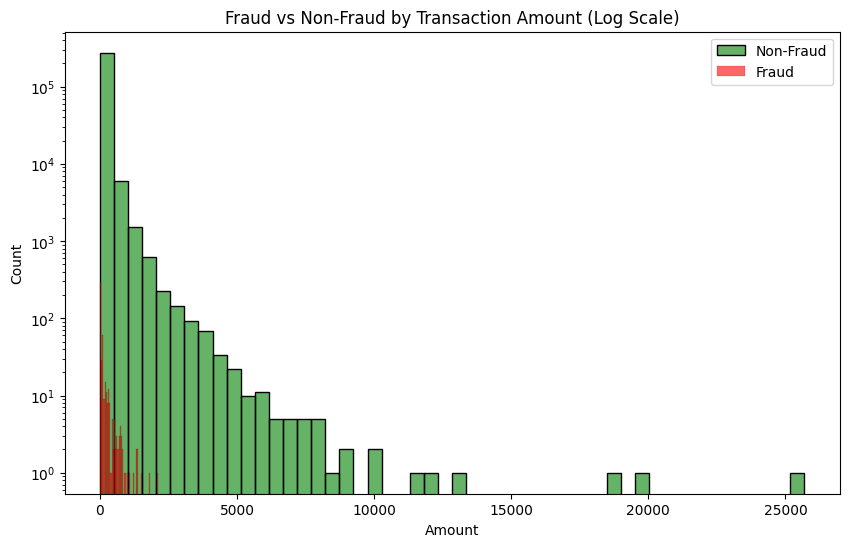

In [23]:
# Fraud vs Non-Fraud by Amount (log scale for better view)
plt.figure(figsize=(10,6))
sns.histplot(df[df['Class']==0]['Amount'], bins=50, color='green', label="Non-Fraud", alpha=0.6)
sns.histplot(df[df['Class']==1]['Amount'], bins=50, color='red', label="Fraud", alpha=0.6)
plt.yscale("log")
plt.legend()
plt.title("Fraud vs Non-Fraud by Transaction Amount (Log Scale)")
plt.show()

# Transaction Amount by Class

In [6]:

fig = px.box(df, x="Class", y="Amount", color="Class",
             title="Transaction Amounts by Class")
fig.show()


# Transaction Time vs Amount

In [7]:
fig = px.scatter(df, x="Time", y="Amount", color="Class",
                 title="Transaction Time vs Amount")
fig.show()


# Correlation Heatmap

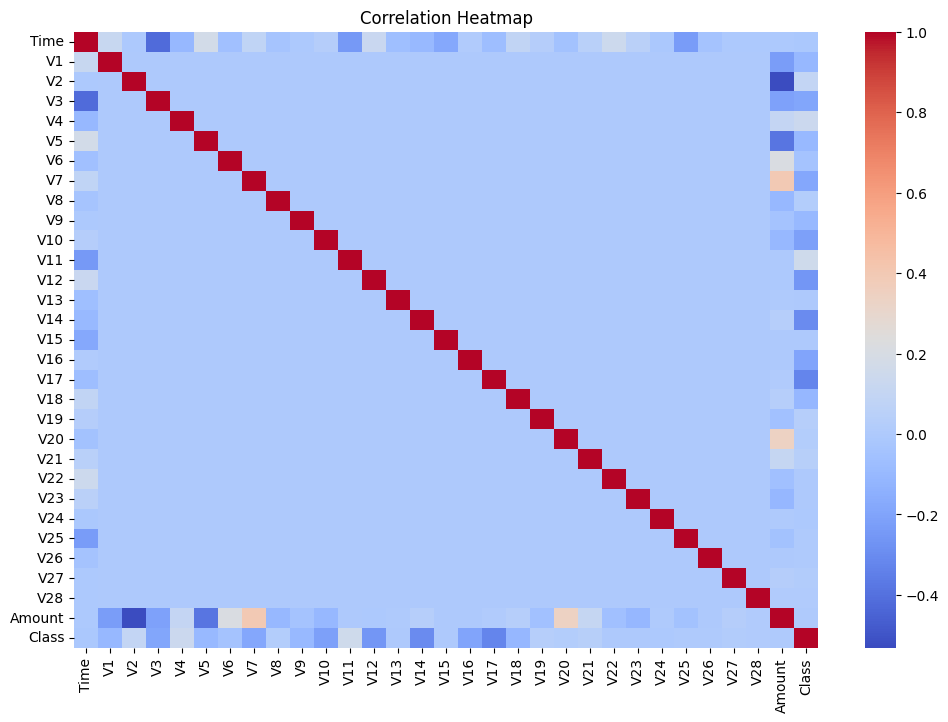

In [8]:
plt.figure(figsize=(12,8))
sns.heatmap(df.corr(), cmap="coolwarm", cbar=True)
plt.title("Correlation Heatmap")
plt.show()

# PCA Visualization (2D)

In [9]:
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df.drop("Class", axis=1))

pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_data)

df_pca = pd.DataFrame(pca_result, columns=["PC1", "PC2"])
df_pca["Class"] = df["Class"]

fig = px.scatter(df_pca, x="PC1", y="PC2", color="Class",
                 title="PCA Visualization (2 Components)")
fig.show()

# PCA Visualization (3D Advanced)

In [10]:
pca_3d = PCA(n_components=3)
pca_result_3d = pca_3d.fit_transform(scaled_data)

df_pca3d = pd.DataFrame(pca_result_3d, columns=["PC1", "PC2", "PC3"])
df_pca3d["Class"] = df["Class"]

fig = px.scatter_3d(df_pca3d, x="PC1", y="PC2", z="PC3",
                    color="Class",
                    title="PCA Visualization (3D)")
fig.show()

# Fraud Transactions Over Time

In [11]:
fraud = df[df['Class']==1]

fig = px.histogram(fraud, x="Time", nbins=50,
                   title="Fraud Transactions Over Time",
                   color_discrete_sequence=["red"])
fig.show()

# Fraud vs Non-Fraud Count

/tmp/ipython-input-572577598.py:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




Text(0.5, 1.0, 'Fraud vs Non-Fraud Count')

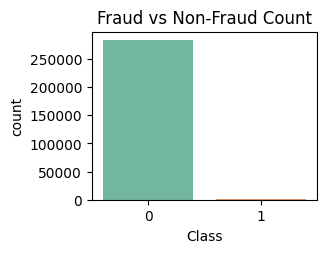

In [13]:
plt.subplot(2,2,1)
sns.countplot(x="Class", data=df, palette="Set2")
plt.title("Fraud vs Non-Fraud Count")

# Transaction Amount Distribution

Text(0.5, 1.0, 'Transaction Amount Distribution')

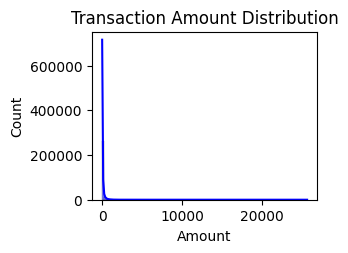

In [14]:
plt.subplot(2,2,2)
sns.histplot(df['Amount'], bins=100, kde=True, color="blue")
plt.title("Transaction Amount Distribution")

# Fraud Amount Distribution

Text(0.5, 1.0, 'Fraudulent Transaction Amounts')

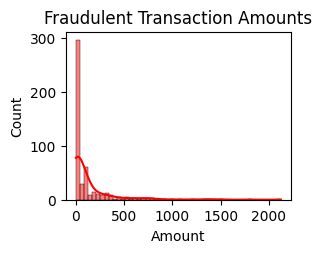

In [15]:
plt.subplot(2,2,3)
sns.histplot(fraud['Amount'], bins=50, kde=True, color="red")
plt.title("Fraudulent Transaction Amounts")

# Fraud Transactions Over Time

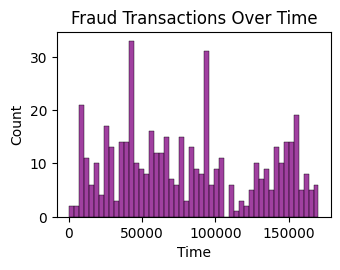

In [16]:
plt.subplot(2,2,4)
sns.histplot(fraud['Time'], bins=50, kde=False, color="purple")
plt.title("Fraud Transactions Over Time")

plt.tight_layout()
plt.show()


# Interactive Dashboard with Plotly Subplots

In [25]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=2, cols=2, subplot_titles=(
    "Fraud vs Non-Fraud Count",
    "Transaction Amount Distribution",
    "Fraudulent Transaction Amounts",
    "Fraud Transactions Over Time"
))

# Transaction Amounts (All)

In [18]:

fig.add_trace(go.Histogram(x=df['Amount'], nbinsx=50, marker_color="blue"),
              row=1, col=2)

# Fraudulent Transaction Amounts

In [19]:

fig.add_trace(go.Histogram(x=fraud['Amount'], nbinsx=50, marker_color="red"),
              row=2, col=1)


# Fraud Over Time

In [20]:


fig.add_trace(go.Histogram(x=fraud['Time'], nbinsx=50, marker_color="purple"),
              row=2, col=2)

fig.update_layout(title_text="Interactive Dashboard of Fraud Analysis", height=800, showlegend=False)
fig.show()